In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
sns.set_theme(style="darkgrid")
import calendar

In [2]:
df_final = pd.read_csv('./data/FINAL_CORD_DATA.csv')
df_final.head()

,sha,title,abstract,publish_time,authors,url,body_text
0,82df15cd2620c224affd4ce100e7fac7fcff7b10; 67f7...,Deconvoluting Lipid Nanoparticle Structure for...,[Image: see text] Lipid nanoparticle (LNP) pac...,2020-05-06,"Eygeris, Yulia; Patel, Siddharth; Jozic, Anton...",https://doi.org/10.1021/acs.nanolett.0c01386; ...,mRNA-based therapies and vaccines hold tremend...
1,1e7e71936cb8aa74a8c9e8ba90c5d729dec7f405,Predictability in Contemporary Medicine,Medical practice is increasingly coming under ...,2021-06-16,"Ciulla, Michele M.",https://www.ncbi.nlm.nih.gov/pubmed/34222267/;...,The aim of this paper is to present in a histo...
2,cc4e338a21138f18ef26af7b26c5ecc28270d959,Experimental Models of Hepatocellular Carcinom...,SIMPLE SUMMARY: Hepatocellular carcinoma (HCC)...,2021-07-21,"Blidisel, Alexandru; Marcovici, Iasmina; Coric...",https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8...,"Hepatocellular carcinoma (HCC), the most commo..."
3,3114420bfc07e18049a9e7045b42c4de7a30bb81,Cancer and COVID-19: analysis of patient outcomes,Background: We sought to investigate the outco...,2021-07-15,"Aboueshia, Mohamed; Hussein, Mohammad Hosny; A...",https://www.ncbi.nlm.nih.gov/pubmed/34263660/;...,Study data were collected and managed using RE...
4,1ef3ec3dfb9bea22c1060c1c469fc1de5c41f15a,"Haematuria, a widespread petechial rash, and h...",With increasing presentations of headaches fol...,2021-10-07,"Waraich, Ammar; Williams, George",https://www.ncbi.nlm.nih.gov/pubmed/34620638/;...,With increasing presentations of patients with...


In [3]:
#Inspect data
def inspect_data(data):
    return pd.DataFrame(
        {
            "Data Type": data.dtypes,
            "No of levels": data.apply(lambda x:len(x.unique()), axis=0),
            "levels": data.apply(lambda x:x.unique(), axis=0),
            "qtd_null": data.apply(lambda x: x.isnull().sum(), axis=0),
            "pct_null": data.apply(lambda x: x.isnull().sum() * 100 / len(x))
        }
    )

In [4]:
inspect_data(df_final)

,Data Type,No of levels,levels,qtd_null,pct_null
sha,object,29902,[82df15cd2620c224affd4ce100e7fac7fcff7b10; 67f...,0,0.000000
title,object,29838,[Deconvoluting Lipid Nanoparticle Structure fo...,0,0.000000
abstract,object,26305,[[Image: see text] Lipid nanoparticle (LNP) pa...,3535,11.821952
publish_time,object,3536,"[2020-05-06, 2021-06-16, 2021-07-21, 2021-07-1...",0,0.000000
authors,object,29440,"[Eygeris, Yulia; Patel, Siddharth; Jozic, Anto...",274,0.916327
url,object,29902,[https://doi.org/10.1021/acs.nanolett.0c01386;...,0,0.000000
body_text,object,29727,[mRNA-based therapies and vaccines hold tremen...,0,0.000000


In [5]:
df_final['publish_time'] = pd.to_datetime(df_final['publish_time'])

In [6]:
df_final['publish_year'] =  df_final['publish_time'].dt.year
df_final['publish_month'] =  df_final['publish_time'].dt.month
df_final['publish_day'] =  df_final['publish_time'].dt.day

In [7]:
df_final['publish_year'].nunique()

50

In [8]:
df_final['publish_year'].min()

1972

In [9]:
df_final['publish_year'].max()

2022

<Axes: xlabel='publish_year', ylabel='count'>

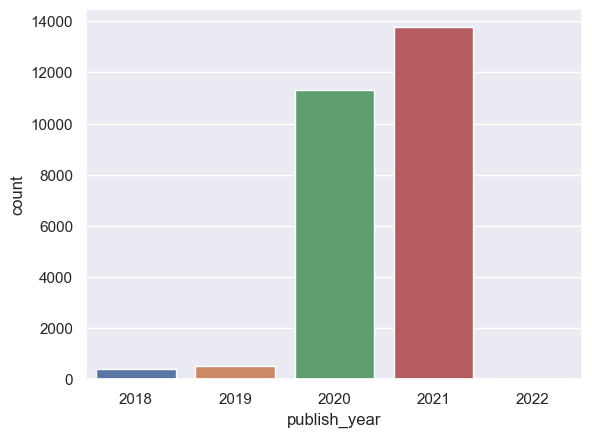

In [10]:
# No.of papers published in recent years
sns.countplot(x="publish_year", data=df_final[df_final['publish_year'].isin([2018, 2019,2020,2021, 2022])])

<Axes: xlabel='publish_month', ylabel='count'>

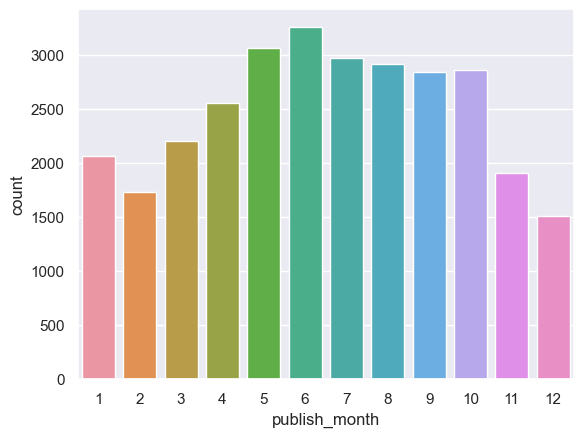

In [11]:
#Month wise distribution of papers published
sns.countplot(x="publish_month", data=df_final)

In [12]:
df_final['publish_month'] = df_final['publish_month'].apply(lambda x : calendar.month_abbr[x])

<Axes: xlabel='publish_month', ylabel='count'>

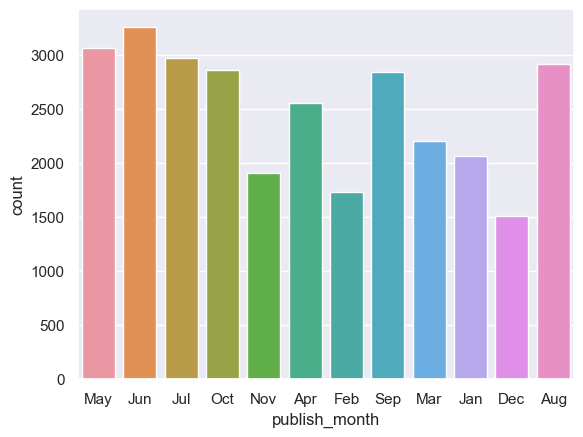

In [13]:
sns.countplot(x="publish_month", data=df_final)

d:\Data Science Projects\BERT-Covid-QA-NLP-Project\venv\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<Axes: xlabel='in_covid_time', ylabel='count'>

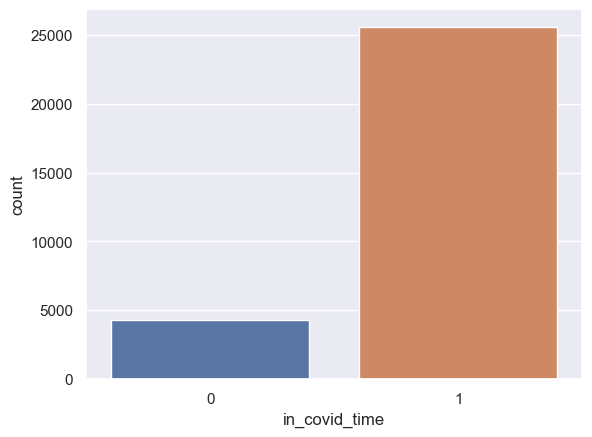

In [14]:
#Checking % of papers published in recent times vs in earlier years
df_final['in_covid_time'] = np.where(df_final['publish_year'].isin([2019,2020,2021]), 1, 0)
sns.countplot(df_final['in_covid_time'])

In [15]:
from wordcloud import WordCloud, STOPWORDS 
import re
import string

In [16]:
def plot_word_cloud(wordcloud):
    plt.figure(figsize=(10, 10))
    plt.imshow(wordcloud) 
    plt.axis("off")

In [17]:
def remove_special_charac_and_punctuations(text) :
  # define the pattern to keep
  pattern = r'[^a-zA-z0-9\'\s]' 
  txt = re.sub(pattern, '', text)
  txt = ''.join([c for c in txt if c not in string.punctuation])
  return  txt

In [18]:
def concat_all_sentences(sents):
   all_tokens = ''
   for text in sents:
        tx = str(text).lower().strip()
        tx = " ".join(tx.split())
        all_tokens += tx + " "
   return all_tokens

In [19]:
## remove special characters and punctuations from titles
cleaned_titles = df_final.loc[df_final.title.notnull(), 'title'].apply(remove_special_charac_and_punctuations)

In [20]:
## remove cleaned abstract
cleaned_abstracts = df_final.loc[df_final.abstract.notnull(), 'abstract'].apply(remove_special_charac_and_punctuations)

In [21]:
title_tokens = concat_all_sentences(cleaned_titles)

In [22]:
abstract_tokens = concat_all_sentences(cleaned_abstracts)

In [23]:
title_tokens

'deconvoluting lipid nanoparticle structure for messenger rna delivery predictability in contemporary medicine experimental models of hepatocellular carcinomaa preclinical perspective cancer and covid19 analysis of patient outcomes haematuria a widespread petechial rash and headaches following the oxford astrazeneca chadox1 ncov19 vaccination detection of viral rna fragments in human ipsc cardiomyocytes following treatment with extracellular vesicles from sarscov2 coding sequence overexpressing lung epithelial cells a model for supplychain decisions for resource sharing with an application to ventilator allocation to combat covid19 futureproof radiation therapist rtt practicein apandemiclessons learnt from covid19 attitude towards covid19 vaccination among healthcare workers a systematic review parallel detection of sarscov2 rna and nucleocapsid antigen in nasopharyngeal specimens from a covid19 patient screening cohort translating sarscov2 wastewaterbased epidemiology for prioritizing

In [24]:
abstract_tokens

'image see text lipid nanoparticle lnp packaged mrna vaccines have been deployed against infectious diseases such as covid19 yet their structural features remain unclear cholesterol a major constituent within lnps contributes to their morphology that influences gene delivery herein we examine the structure of lnps containing cholesterol derivatives using electron microscopy differential scanning calorimetry and membrane fluidity assays lnps formulated with c24 alkyl derivatives of cholesterol show a polymorphic shape and various degrees of multilamellarity and lipid partitioning likely due to phase separation the addition of methyl and ethyl groups to the c24 alkyl tail of the cholesterol backbone induces multilamellarity 50 increase compared to cholesterol while the addition of a double bond induces lipid partitioning 90 increase compared to cholesterol lnps with multilamellar and faceted structures as well as a lamellar lipid phase showed higher gene transfection unraveling the struc

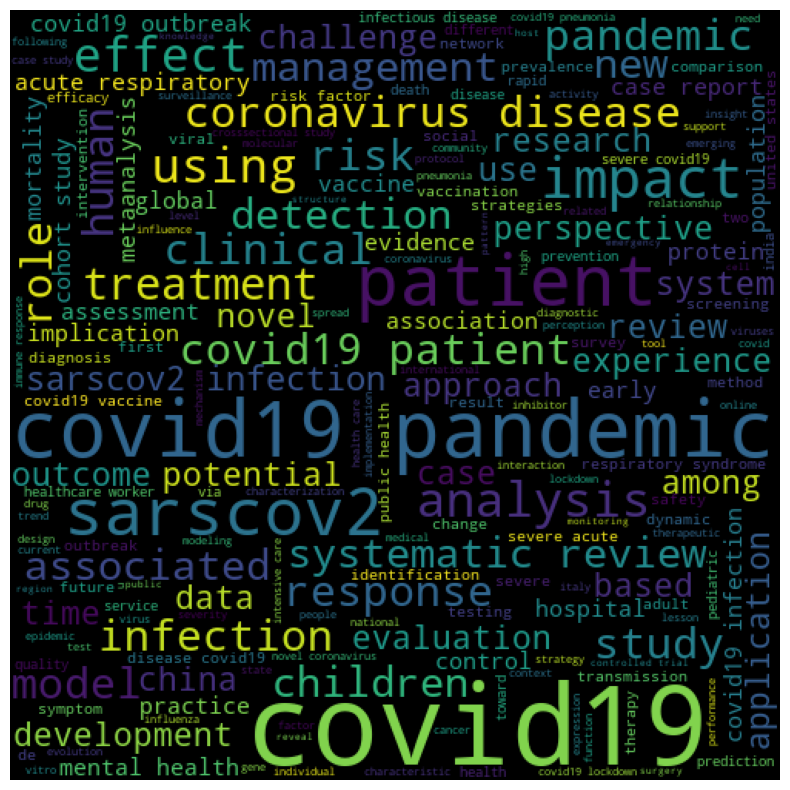

In [25]:
## import pyplot 
import matplotlib.pyplot as plt
#Looking at word cloud of title tokens
title_wordcloud = WordCloud(width = 500, height = 500,random_state=10).generate(title_tokens)
plot_word_cloud(title_wordcloud)

In [27]:
import gensim, spacy, logging, warnings
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel

In [28]:
abstracts = cleaned_abstracts.values.tolist()

In [29]:
#simple_preprocess of genism removes special charcters,numbers and converts into lower case
gensim.utils.simple_preprocess("12 happy today @# '' '\n'", deacc=True) 

['happy', 'today']

In [30]:
def token_builder(sentences) :
   for sent in sentences:     
        sent = gensim.utils.simple_preprocess(str(sent), deacc=True) 
        yield(sent) 

In [31]:
#Building abstract tokens using token_builder
abstract_tokens = list(token_builder(abstracts))

In [32]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(abstract_tokens, min_count=3, threshold=50) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[abstract_tokens], threshold=50)  
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

In [39]:
import nltk as nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk.corpus import stopwords
nlp = spacy.load("en_core_web_sm")

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\kanwa\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\kanwa\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [34]:
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use', 'not', 'would', 'say', 'could', '_', 'be', 'know', 'good', 'go', 'get', 'do', 'done', 'try', 'many', 'some', 'nice', 'thank', 'think', 'see', 'rather', 'easy', 'easily', 'lot', 'lack', 'make', 'want', 'seem', 'run', 'need', 'even', 'right', 'line', 'even', 'also', 'may', 'take', 'come'])

In [42]:
def process_docs(texts, stop_words=stop_words, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    texts = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]
    texts = [bigram_mod[doc] for doc in texts]
    texts = [trigram_mod[bigram_mod[doc]] for doc in texts]
    texts_out = []
    nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    # remove stopwords once more after lemmatization   
    texts_out = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts_out] 
    return texts_out

In [43]:
abstracts_data = process_docs(abstract_tokens)

In [44]:
# Create Dictionary
id2word = corpora.Dictionary(abstracts_data)

In [45]:
print(id2word)

Dictionary<74847 unique tokens: ['addition', 'assay', 'backbone', 'bond', 'cholesterol']...>


In [46]:
print(id2word.token2id)

{'addition': 0, 'assay': 1, 'backbone': 2, 'bond': 3, 'cholesterol': 4, 'compare': 5, 'constituent': 6, 'contain': 7, 'contribute': 8, 'covid': 9, 'delivery': 10, 'deploy': 11, 'derivative': 12, 'differential': 13, 'double': 14, 'due': 15, 'enhance': 16, 'examine': 17, 'faceted': 18, 'feature': 19, 'formulate': 20, 'gene': 21, 'herein': 22, 'high': 23, 'image': 24, 'increase': 25, 'induce': 26, 'influence': 27, 'lamellar': 28, 'likely': 29, 'lipid': 30, 'major': 31, 'morphology': 32, 'mrna_vaccine': 33, 'package': 34, 'partition': 35, 'phase': 36, 'polymorphic': 37, 'rational_design': 38, 'remain_unclear': 39, 'shape': 40, 'show': 41, 'structural': 42, 'structure': 43, 'tail': 44, 'text': 45, 'transfection': 46, 'unravel': 47, 'various_degree': 48, 'well': 49, 'yet': 50, 'acknowledge': 51, 'adequate': 52, 'advent': 53, 'aged': 54, 'aggregation': 55, 'approach': 56, 'begin': 57, 'belong': 58, 'clinical': 59, 'complexity': 60, 'concept': 61, 'confutable': 62, 'consultative': 63, 'context

In [47]:
# Create Corpus: Term Document Frequency
corpus = [id2word.doc2bow(text) for text in abstracts_data]

In [48]:
# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=2, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=10,
                                           passes=10,
                                           alpha='symmetric',
                                           iterations=100,
                                           per_word_topics=True)

In [49]:
print(lda_model.print_topics())

[(0, '0.012*"virus" + 0.012*"sarscov" + 0.012*"infection" + 0.008*"disease" + 0.008*"viral" + 0.008*"protein" + 0.007*"cell" + 0.006*"study" + 0.006*"human" + 0.005*"show"'), (1, '0.021*"covid" + 0.018*"patient" + 0.012*"study" + 0.008*"result" + 0.007*"pandemic" + 0.007*"disease" + 0.006*"case" + 0.006*"method" + 0.005*"datum" + 0.005*"high"')]


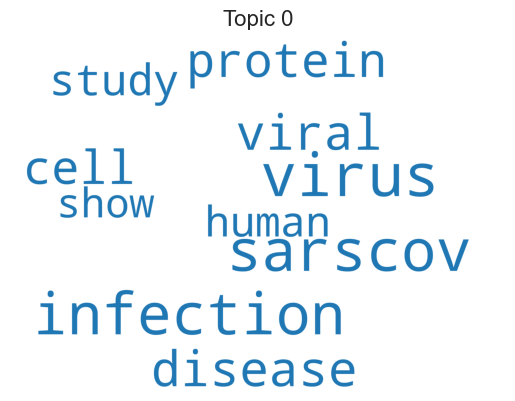

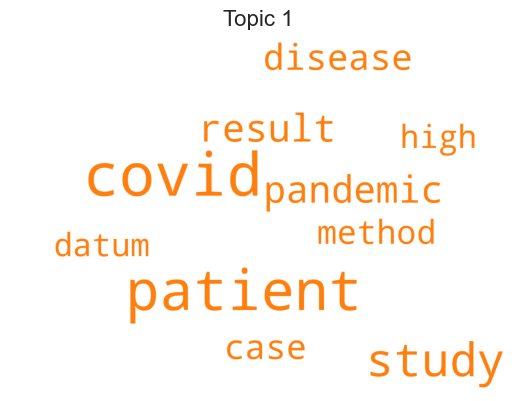

In [50]:
import matplotlib.colors as mcolors
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=stop_words,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)


topics = lda_model.show_topics(formatted=False)

for i in range(0,2):
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    plt.show()

In [51]:
topics = lda_model.show_topics(formatted=False)

In [52]:
topics

[(0,
  [('virus', 0.012268874),
   ('sarscov', 0.011762504),
   ('infection', 0.0115041),
   ('disease', 0.008096585),
   ('viral', 0.0079396395),
   ('protein', 0.007573343),
   ('cell', 0.0073335366),
   ('study', 0.006280247),
   ('human', 0.005870666),
   ('show', 0.0054826015)]),
 (1,
  [('covid', 0.020669876),
   ('patient', 0.018391335),
   ('study', 0.011915307),
   ('result', 0.007716267),
   ('pandemic', 0.0074562794),
   ('disease', 0.0067548775),
   ('case', 0.0062066144),
   ('method', 0.0056837886),
   ('datum', 0.005436325),
   ('high', 0.005339758)])]